## **Importing Libraries**


In [1]:
#Import Library yang digunakan

import os
import numpy as np

import pandas as pd
from tqdm.auto import tqdm

from nltk.tokenize import word_tokenize
from gensim.models import FastText

# **Stopwords**


In [2]:
# Membuat List Stopword

from nltk.corpus import stopwords
from string import punctuation

sw = stopwords.words("indonesian") + list(punctuation)

# **Load Data and Cleaning Data**


In [3]:
# Data for Train

df = pd.read_csv("/Users/nikitaandrea/Documents/LOMBA/GELAR RASA/translated data/bola_translated.csv")
df.head(3)

,Unnamed: 0,Date Created,Number of Likes,Source of Tweet,Tweet,Sentiment,Indonesian_Text
0,0,2022-11-20 23:59:21+00:00,4,Twitter Web App,What are we drinking today @TucanTribe \n@MadB...,neutral,Apa yang kita minum hari ini @Tucantribe\n@Mad...
1,1,2022-11-20 23:59:01+00:00,3,Twitter for iPhone,Amazing @CanadaSoccerEN #WorldCup2022 launch ...,positive,Video peluncuran @Canadasocceren #WorldCup2022...
2,2,2022-11-20 23:58:41+00:00,1,Twitter for iPhone,Worth reading while watching #WorldCup2022 htt...,positive,Layak dibaca saat menonton #WorldCup2022 https...


In [4]:
df = df.dropna()

In [5]:
df = df.drop_duplicates()

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 7000 entries, 0 to 6999
Data columns (total 7 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   Unnamed: 0       7000 non-null   int64 
 1   Date Created     7000 non-null   object
 2   Number of Likes  7000 non-null   int64 
 3   Source of Tweet  7000 non-null   object
 4   Tweet            7000 non-null   object
 5   Sentiment        7000 non-null   object
 6   Indonesian_Text  7000 non-null   object
dtypes: int64(2), object(5)
memory usage: 437.5+ KB


In [7]:
df["Sentiment"].value_counts()

Sentiment
neutral     2710
positive    2240
negative    2050
Name: count, dtype: int64

In [8]:
df.tail()

,Unnamed: 0,Date Created,Number of Likes,Source of Tweet,Tweet,Sentiment,Indonesian_Text
6995,6995,2022-11-20 16:14:17+00:00,0,Twitter for iPhone,Referee checking his bank balance before makin...,negative,Wasit memeriksa saldo banknya sebelum membuat ...
6996,6996,2022-11-20 16:14:16+00:00,1,Twitter for Android,Erm.... What?\n\n#WorldCup2022 #Qatar2022,neutral,Erm .... apa?\n\n#WorldCup2022 #Qatar2022
6997,6997,2022-11-20 16:14:16+00:00,0,Twitter for iPhone,@bruce_arthur This #WorldCup2022 is so dirty I...,negative,@bruce_arthur ini #worldcup2022 sangat kotor s...
6998,6998,2022-11-20 16:14:15+00:00,1,Twitter for iPhone,Corruption at it’s finest ! It’s going to be a...,positive,Korupsi yang terbaik!Ini akan menjadi Piala Du...
6999,6999,2022-11-20 16:14:15+00:00,3,Twitter for iPad,"FIFA wanted to talk about the football, then t...",negative,"FIFA ingin berbicara tentang sepak bola, lalu ..."


# **Normalization Text**


In [9]:
import re

def normalize_tweet(tweet):
    # Hapus tanda baca menggunakan regular expression
    tweet_without_punct = re.sub(r'[^\w\s]', '', tweet)
    
    # Hapus emotikon menggunakan regular expression
    tweet_without_emoticons = re.sub(r'[\U0001F600-\U0001F650]', '', tweet_without_punct)
    
    # Hilangkan nama pengguna Twitter (@username)
    tweet_without_usernames = re.sub(r'@\S+', '', tweet_without_emoticons)
    
    # Hilangkan hashtag (#tag)
    tweet_without_hashtags = re.sub(r'#\S+', '', tweet_without_usernames)
    
    # Hilangkan alamat web atau link
    tweet_without_links = re.sub(r'http\S+', '', tweet_without_hashtags)
    
    # Konversi semua huruf menjadi huruf kecil
    tweet_lowercase = tweet_without_links.lower()
    
    return tweet_lowercase


df["Indonesian_Text"] = df["Indonesian_Text"].astype(str)
df["Indonesian_Text"] = [normalize_tweet(text) for text in df["Indonesian_Text"]]


# **Encoding Label**


In [10]:
from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()

urutan = ["negative", 'neutral', "positive"]

label_encoder.fit(urutan)

df["Sentiment"] = label_encoder.transform(df["Sentiment"])


In [11]:
df

,Unnamed: 0,Date Created,Number of Likes,Source of Tweet,Tweet,Sentiment,Indonesian_Text
0,0,2022-11-20 23:59:21+00:00,4,Twitter Web App,What are we drinking today @TucanTribe \n@MadB...,1,apa yang kita minum hari ini tucantribe\nmadbe...
1,1,2022-11-20 23:59:01+00:00,3,Twitter for iPhone,Amazing @CanadaSoccerEN #WorldCup2022 launch ...,2,video peluncuran canadasocceren worldcup2022 y...
2,2,2022-11-20 23:58:41+00:00,1,Twitter for iPhone,Worth reading while watching #WorldCup2022 htt...,2,layak dibaca saat menonton worldcup2022
3,3,2022-11-20 23:58:33+00:00,1,Twitter Web App,Golden Maknae shinning bright\n\nhttps://t.co/...,2,golden maknae bersinar terang\n\n\njenenjungok...
4,4,2022-11-20 23:58:28+00:00,0,Twitter for Android,"If the BBC cares so much about human rights, h...",0,jika bbc begitu peduli tentang hak asasi manus...
...,...,...,...,...,...,...,...
6995,6995,2022-11-20 16:14:17+00:00,0,Twitter for iPhone,Referee checking his bank balance before makin...,0,wasit memeriksa saldo banknya sebelum membuat ...
6996,6996,2022-11-20 16:14:16+00:00,1,Twitter for Android,Erm.... What?\n\n#WorldCup2022 #Qatar2022,1,erm apa\n\nworldcup2022 qatar2022
6997,6997,2022-11-20 16:14:16+00:00,0,Twitter for iPhone,@bruce_arthur This #WorldCup2022 is so dirty I...,0,bruce_arthur ini worldcup2022 sangat kotor seh...
6998,6998,2022-11-20 16:14:15+00:00,1,Twitter for iPhone,Corruption at it’s finest ! It’s going to be a...,2,korupsi yang terbaikini akan menjadi piala dun...


# **Tokenize and Train Fasttext model**


In [12]:
kalimat = [
    [word for word in word_tokenize(tweet.lower()) if word not in sw]
    for tweet in tqdm(df['Indonesian_Text'])
]
kalimat[:5]

  0%|          | 0/7000 [00:00<?, ?it/s]

[['minum',
  'tucantribe',
  'madbears_',
  'lkinc_algo',
  'al_goanna',
  'worldcup2022'],
 ['video',
  'peluncuran',
  'canadasocceren',
  'worldcup2022',
  'biasamenunjukkan',
  'betapa',
  'wajah',
  'kanada',
  'tim',
  'nasional',
  'pria',
  'berubah',
  'entri',
  'piala',
  'dunia',
  '1986',
  'sabar',
  'anak',
  'anak',
  'beraksi',
  'kanada',
  'video',
  'pembukaan',
  'piala',
  'dunia',
  'fifa'],
 ['layak', 'dibaca', 'menonton', 'worldcup2022'],
 ['golden',
  'maknae',
  'bersinar',
  'terang',
  'jenenjungok',
  'jungkook',
  '전정국',
  '정국',
  'jk',
  'goldenmaknae',
  'bunny',
  'kookie',
  'jungshook',
  'bts',
  '방탄',
  '소년단',
  'worldcup2022',
  'fifakook',
  'bts_twt'],
 ['bbc',
  'peduli',
  'hak',
  'asasi',
  'manusia',
  'hak',
  'hak',
  'homoseksual',
  'hak',
  'perempuan',
  'upacara',
  'pembukaan',
  'upacara',
  'pembukaan',
  'bbc',
  'menyensor',
  'upacara',
  'pembukaan',
  'worldcup2022']]

In [13]:
# melatih Fast Text

model_ft = FastText(kalimat, vector_size=300, window=3, min_count=5, epochs= 500, sg=0, hs=0)

In [14]:
# Menyimpan Model Fast Text

model_ft.save('/Users/nikitaandrea/Documents/LOMBA/GELAR RASA/model_ft.bin')

In [15]:
ft = model_ft.wv

In [16]:
ft["saya"]

array([-9.74576831e-01,  3.20706517e-02,  1.15725350e+00, -2.23175097e+00,
        1.68884754e+00,  4.11645114e-01,  6.65618241e-01, -9.13466632e-01,
        9.34618264e-02,  8.76943767e-01, -4.33859736e-01,  1.57922244e+00,
       -1.59117889e+00, -1.07538223e+00, -1.54230034e+00,  1.00231898e+00,
       -7.90925860e-01,  1.27627701e-01,  9.45319951e-01,  9.66338515e-01,
        1.52481034e-01,  1.34467930e-01, -8.39282393e-01, -1.14192702e-01,
        5.24770916e-01,  7.88937449e-01, -2.49020308e-01, -3.43436480e-01,
        3.98564823e-02,  5.88362098e-01, -1.78613639e+00,  1.53986919e+00,
        2.87355840e-01,  4.74446714e-01, -5.92231631e-01,  1.04782188e+00,
        1.48118034e-01, -1.09099254e-01,  9.45882201e-01, -2.31156945e-02,
        4.63915646e-01,  1.75442767e+00,  8.58068585e-01, -1.62657380e+00,
       -1.94462299e-01,  2.56595969e+00,  5.78143120e-01,  3.83860499e-01,
       -1.05333245e+00,  2.59153318e+00, -3.47763956e-01, -1.00049518e-01,
        5.86246431e-01,  

In [17]:
ft.similar_by_word("oper", topn=7)

[('super', 0.5982524752616882),
 ('kiper', 0.5687996745109558),
 ('keeper', 0.5662299394607544),
 ('tipster', 0.40012189745903015),
 ('seluler', 0.35574862360954285),
 ('alanshearer', 0.33443349599838257),
 ('beer', 0.32383275032043457)]

# **Visualize FastText Model**


In [18]:
from umap import UMAP
import plotly.express as px

In [19]:
X = UMAP().fit_transform(ft.vectors)

In [20]:
df1 = df.copy
df1 = pd.DataFrame(X, columns=["umap1", "umap2"])
df1["Indonesian_Text"] = ft.index_to_key

In [21]:
fig = px.scatter(df1, x="umap1", y="umap2", text="Indonesian_Text")
fig.update_traces(textposition="top center")
fig.update_layout(
    height = 800,
    title_text='Reduced FastText'
)
fig.show()

# **Convert Word vector to sentence Vector**

In [22]:
from collections import Counter
import numpy as np

def get_sentence_vector(sentence, model, weighted=False):
    # Split kalimat menjadi kata-kata
    words = sentence.split()

    # Hitung frekuensi kemunculan kata dalam kalimat
    word_freq = Counter(words)

    # Inisialisasi vektor kalimat
    sentence_vector = [model.wv[word] * word_freq[word] for word in word_freq]

    if weighted:
        # Hitung weighted average vektor kata dalam kalimat
        total_weight = sum(word_freq.values())
        sentence_vector = sum(sentence_vector) / total_weight

    return sentence_vector

df['Sentence_Vector_Avg'] = df['Indonesian_Text'].apply(lambda x: get_sentence_vector(x, model_ft, weighted=True))

In [23]:
df

,Unnamed: 0,Date Created,Number of Likes,Source of Tweet,Tweet,Sentiment,Indonesian_Text,Sentence_Vector_Avg
0,0,2022-11-20 23:59:21+00:00,4,Twitter Web App,What are we drinking today @TucanTribe \n@MadB...,1,apa yang kita minum hari ini tucantribe\nmadbe...,"[-0.07233605, -0.17696838, -0.18789922, -0.328..."
1,1,2022-11-20 23:59:01+00:00,3,Twitter for iPhone,Amazing @CanadaSoccerEN #WorldCup2022 launch ...,2,video peluncuran canadasocceren worldcup2022 y...,"[-0.4306266, -0.18460406, 0.43524837, 0.275329..."
2,2,2022-11-20 23:58:41+00:00,1,Twitter for iPhone,Worth reading while watching #WorldCup2022 htt...,2,layak dibaca saat menonton worldcup2022,"[-0.35015246, -0.3254753, 0.32113963, 0.376059..."
3,3,2022-11-20 23:58:33+00:00,1,Twitter Web App,Golden Maknae shinning bright\n\nhttps://t.co/...,2,golden maknae bersinar terang\n\n\njenenjungok...,"[-0.0727235, 0.35244304, 0.084125556, 0.196101..."
4,4,2022-11-20 23:58:28+00:00,0,Twitter for Android,"If the BBC cares so much about human rights, h...",0,jika bbc begitu peduli tentang hak asasi manus...,"[0.023605319, -0.49597472, 0.18400565, -0.5635..."
...,...,...,...,...,...,...,...,...
6995,6995,2022-11-20 16:14:17+00:00,0,Twitter for iPhone,Referee checking his bank balance before makin...,0,wasit memeriksa saldo banknya sebelum membuat ...,"[0.23210905, 0.26082504, 0.43906367, 0.2785138..."
6996,6996,2022-11-20 16:14:16+00:00,1,Twitter for Android,Erm.... What?\n\n#WorldCup2022 #Qatar2022,1,erm apa\n\nworldcup2022 qatar2022,"[-0.61392975, -0.7666728, 0.69740117, 0.012811..."
6997,6997,2022-11-20 16:14:16+00:00,0,Twitter for iPhone,@bruce_arthur This #WorldCup2022 is so dirty I...,0,bruce_arthur ini worldcup2022 sangat kotor seh...,"[0.14304373, 0.0923096, 0.08573533, 0.02779947..."
6998,6998,2022-11-20 16:14:15+00:00,1,Twitter for iPhone,Corruption at it’s finest ! It’s going to be a...,2,korupsi yang terbaikini akan menjadi piala dun...,"[-0.4739469, 0.015653133, 0.4774837, 0.1540426..."


# **Splitting Data Train and Test**


In [24]:
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, classification_report
from sklearn.model_selection import train_test_split

X = np.vstack(df['Sentence_Vector_Avg'].values)
y = df['Sentiment']

# Bagi dataset menjadi data latih dan data uji
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [25]:
# Load model Fast Text
model_ft = FastText.load('/Users/nikitaandrea/Documents/LOMBA/GELAR RASA/model_ft.bin')

# **Train Model for Predict**


In [26]:
from sklearn.model_selection import RandomizedSearchCV
from jcopml.tuning import random_search_params as rsp
from sklearn.pipeline import Pipeline

In [27]:
# Train Model Machine Learning

from xgboost import XGBClassifier

# Definisikan pipeline
pipeline_xgb = Pipeline([
    ('algo', XGBClassifier())
])

# Lakukan RandomizedSearchCV untuk mencari parameter terbaik
model_xgb = RandomizedSearchCV(pipeline_xgb, rsp.xgb_params, cv=4, n_iter=50, scoring='accuracy', n_jobs=-1, verbose=1, random_state=42)
model_xgb.fit(X_train, y_train)

# Tampilkan parameter terbaik dan performa model
print(model_xgb.best_params_)
print(model_xgb.score(X_train, y_train), model_xgb.best_score_, model_xgb.score(X_test, y_test))


Fitting 4 folds for each of 50 candidates, totalling 200 fits
{'algo__colsample_bytree': 0.9763799669573133, 'algo__gamma': 3, 'algo__learning_rate': 0.05820013372709852, 'algo__max_depth': 4, 'algo__n_estimators': 163, 'algo__reg_alpha': 0.07362945281639222, 'algo__reg_lambda': 2.752717392942944, 'algo__subsample': 0.6401537692938899}
0.8480357142857143 0.6139285714285715 0.6035714285714285


# **Validation**


In [28]:
# Classification Report

y_pred = model_xgb.predict(X_test)
report = classification_report(y_test, y_pred)
print("Classification Report:\n", report)

Classification Report:
               precision    recall  f1-score   support

           0       0.62      0.62      0.62       397
           1       0.56      0.61      0.58       526
           2       0.65      0.58      0.62       477

    accuracy                           0.60      1400
   macro avg       0.61      0.60      0.61      1400
weighted avg       0.61      0.60      0.60      1400



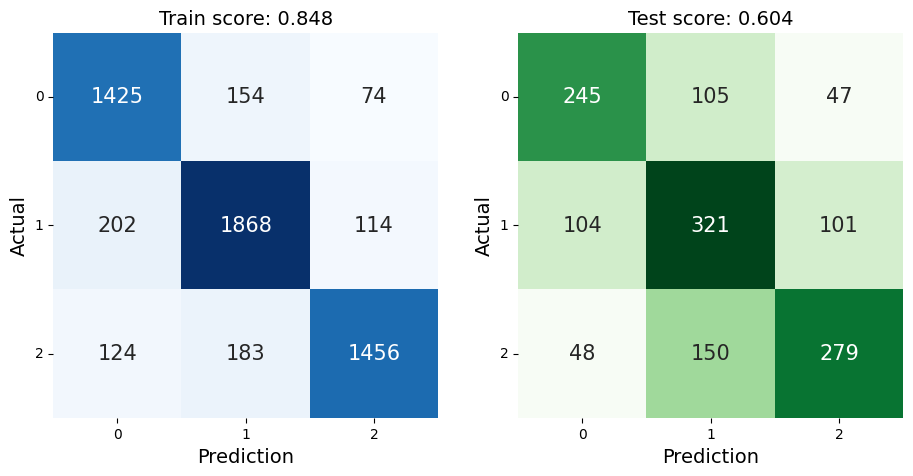

In [29]:
from jcopml.plot import plot_confusion_matrix
plot_confusion_matrix(X_train, y_train, X_test, y_test, model_xgb)

# **Predict New Data**


In [30]:
# Teks baru yang akan diprediksi
new_text = "pemain itu selalu hebat"

normalized_text = normalize_tweet(new_text)

new_text_feature = get_sentence_vector(normalized_text, model_ft, weighted=True)

predicted_sentiment = model_xgb.predict(new_text_feature.reshape(1, -1))
print(f"Prediksi sentimen untuk teks '{new_text}': {predicted_sentiment}")


Prediksi sentimen untuk teks 'pemain itu selalu hebat': [2]


In [31]:
# Data for predict

df_crawl = pd.read_csv("/Users/nikitaandrea/Documents/LOMBA/GELAR RASA/pildun-2.csv", sep=';')
df_crawl1 = pd.read_csv("/Users/nikitaandrea/Documents/LOMBA/GELAR RASA/piala-2.csv", sep=';')
df_crawl2 = pd.read_csv("/Users/nikitaandrea/Documents/LOMBA/GELAR RASA/timnasindo.csv", sep=';')
df_crawl3 = pd.read_csv("/Users/nikitaandrea/Documents/LOMBA/GELAR RASA/garuda-2.csv", sep=';')

df_crawl = pd.concat([df_crawl['full_text'], df_crawl1['full_text'], df_crawl2['full_text'], df_crawl3['full_text']], ignore_index=True)

df_crawl = pd.DataFrame(df_crawl).astype(str)


In [32]:
df_crawl

,full_text
0,Jepang Menang Tipis Atas Polandia di Piala Dun...
1,Presiden FIFA Terkesima dengan Atmosfer Indone...
2,Hasil Jepang U-17 Vs Polandia U-17: Samurai Bi...
3,Penonton Piala Dunia U-17 Keluhkan Masalah Car...
4,#Foto Presiden Jokowi menonton Timnas Indonesi...
...,...
3913,Kabar duka menyelimuti dunia sepak bola Tanah ...
3914,Sergio Aguero harus berhenti bermain sepakbola...
3915,Megabintang sepakbola Portugal Cristiano Ronal...
3916,Pertandingan sepak bola di JIS dicemari aksi r...


In [33]:
# Normalisasi Data untuk dimasukkan ke model
df_crawl['text'] = [normalize_tweet(text) for text in df_crawl['full_text']]

df_crawl['text_vec'] = df_crawl['text'].apply(lambda x: get_sentence_vector(x, model_ft, weighted=True))
predicted = np.vstack(df_crawl['text_vec'].values)

In [34]:
# Prediksi model
predicted_sentiment = model_xgb.predict(predicted)

sentiment = pd.Series(predicted_sentiment)
sentiment = sentiment.replace({1: 'Neutral', 0: 'Negatif', 2: 'Positif'})
sentiment.value_counts()


Positif    1562
Neutral    1345
Negatif    1011
Name: count, dtype: int64

# **Prediction**


In [35]:
pd.set_option('display.max_colwidth', None)

textr = df_crawl['text']
hasil = pd.DataFrame({'text': textr, 'sentiment': sentiment})
hasil.set_index('sentiment', inplace=True)
hasil.sample(5)


,text
sentiment,
Negatif,gubernur bali wayan koster menolak israel berlaga hingga berujung ri batal jadi host piala dunia u20 ternyata salah satu alasan berkaitan dengan bom bali
Negatif,alumni 212 lakukan demonstrasi tolak kedatangan timnas israel untuk bermain dalam piala dunia u20 di indonesia mereka menolak karena israel jajah palestina
Neutral,bek kiri timnas indonesia pratama arhan dikabarkan akan menyeberang ke korea selatan ia diklaim akan bergabung ke klub k league 1 suwon fc
Positif,lionel messi ingin psg mengabulkan permintaan memamerkan trofi piala dunia di markas les parisiens stadion parc des princes cnnindonesia detiknetwork
Neutral,malam ini 165 timnas indonesia melawan timnas thailand berikut jadwal dan link streaming final sea games 2023 indonesia vs thailand via detiksumut_


# **Visualize New data**


In [36]:
# Memvisualisasikan Hasil prediksi
sentiment_counts = sentiment.value_counts().reset_index()
sentiment_counts.columns = ['Sentiment', 'Count']

fig = px.bar(sentiment_counts, x='Sentiment', y='Count', color='Sentiment',
             title='Jumlah Sentimen',
             labels={'Count': 'Jumlah', 'Sentiment': 'Sentimen'},
             color_discrete_map={'Neutral': 'blue', 'Negatif': 'red', 'Positif': 'green'})

fig.show()


In [37]:
# Membuat Wordcloud
from wordcloud import WordCloud
import plotly.graph_objects as go

all_text = ' '.join(df_crawl['text'].astype(str).tolist())

wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_text)

fig = go.Figure(go.Image(z=wordcloud.to_array()))
fig.update_layout(title='Word Cloud dari full_text', title_x=0.5)
fig.show()
